In [2]:
import random
from collections import defaultdict
import pandas as pd
import os
from PIL import Image
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import torch
import matplotlib.pyplot as plt
import numpy as np
from ModelFaceReID import FaceEmbeddingCNN
import pickle

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

DATA FROM FILES
The 'identity_CelebA.txt' file contains photo names with assigned celebrity identity indexes.

My face dataset doesn't include all the photos that the 'identity_CelebA.txt' file contains, so I filtEr the file.

In [4]:
data_file = "identity_CelebA.txt"
data_df = pd.read_csv(data_file, sep=" ", header=None, names=["image", "id"])

images_folder = "images"

# DATA FILTERING
existing_images = set(os.listdir(images_folder)) # all file names set
data_df = data_df[data_df["image"].isin(existing_images)].reset_index(drop=True)

# SORTING BY ID
data_df = data_df.sort_values(by="id").reset_index(drop=True)

## 100 UNIQUE CELEBRITIES TO TEST THE MODEL

In [5]:
# 100 unique people
unique_ids = data_df["id"].unique()[:100]
selected_data = data_df[data_df["id"].isin(unique_ids)]

celebrities = []
test_data = []

for person_id in unique_ids:
    person_images = selected_data[selected_data["id"] == person_id]["image"].tolist()
    
    if len(person_images) <= 3:
        celebrities.extend([(img, person_id) for img in person_images])
    else:
        test_images = random.sample(person_images, 3)
        celebrities_image = [img for img in person_images if img not in test_images]
        test_data.extend([(img, person_id) for img in test_images])
        celebrities.extend([(img, person_id) for img in celebrities_image])

print(f"Number of celebrities photos : {len(celebrities)}")
print(f"Number of celebrities photos to test face recognition : {len(test_data)}")

Number of celebrities photos : 256
Number of celebrities photos to test face recognition : 291


TRANSFORMATION

In [6]:
transform = transforms.Compose([
    transforms.Resize((96, 96)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

In [7]:
class ImageDataset(Dataset):
    def __init__(self, data, images_folder, transform=None):
        self.data = data
        self.images_folder = images_folder
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        image_name, label = self.data[idx]
        image_path = os.path.join(self.images_folder, image_name)
        image = Image.open(image_path).convert("RGB")
        
        if self.transform:
            image = self.transform(image)
        
        return image, label

DATA LOADING

In [ ]:
batch_size = 32

In [8]:
celebrities_dataset = ImageDataset(celebrities, images_folder, transform=transform)
celebrities_loader = DataLoader(celebrities_dataset, batch_size=batch_size, shuffle=False)

test_dataset = ImageDataset(test_data, images_folder, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

TRAINED MODEL with parameters from file 'trained_model.pth'

In [9]:
model = FaceEmbeddingCNN()
model.load_state_dict(torch.load("trained_model.pth", weights_only=True))
model = model.to(device)
model.eval()

FaceEmbeddingCNN(
  (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv4): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (global_avg_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc1): Linear(in_features=256, out_features=128, bias=True)
)

## Embeddings for 100 celebrities

In [10]:
embeddings_dict = defaultdict(list)

with torch.no_grad():
    for images, labels in celebrities_loader:
        images = images.to(device)
        embeddings = model(images) 
        
        for embedding, label in zip(embeddings, labels):
            embeddings_dict[label.item()].append(embedding.cpu().numpy())


### Saving embeddings to the 'celebrities_embeddings.pkl' file

In [11]:
with open("celebrities_embeddings.pkl", "wb") as f:
    pickle.dump(embeddings_dict, f)

print("Embeddings saved.")

Embeddings saved.


In [12]:
with open("celebrities_embeddings.pkl", "rb") as f:
    celeb_embeddings_dict = pickle.load(f)

### Embeddings of test images

In [13]:
test_embeddings_dict = defaultdict(list)

with torch.no_grad():
    for images, labels in test_loader:
        images = images.to(device)
        embeddings = model(images)

        for embedding, label in zip(embeddings, labels):
            test_embeddings_dict[label.item()].append(embedding.cpu().numpy())

Euclidean distance for comparison images

In [14]:
def euclidean_distance(a, b):
    return np.linalg.norm(a - b)

## Celebrity photo embedding comparison - Face Recognition

In [15]:
results = []

for test_label, test_embeddings in test_embeddings_dict.items():
    for test_embedding in test_embeddings:
        closest_label, closest_distance = None, float("inf")
        
        for celeb_label, celeb_embeddings in celeb_embeddings_dict.items():
            
            mean_celeb_embedding = np.mean(celeb_embeddings, axis=0)
            distance = euclidean_distance(test_embedding, mean_celeb_embedding)

            if distance < closest_distance:
                closest_label = celeb_label
                closest_distance = distance
                    
        results.append({
            "test_label": test_label,
            "closest_label": closest_label,
            "distance": closest_distance
        })

for result in results:
    print(f"Test Image: {result['test_label']} ---> Closest Match Label: {result['closest_label']} --- Distance: {result['distance']:.4f}")

Test Image: 1 ---> Closest Match Label: 66 --- Distance: 0.2795
Test Image: 1 ---> Closest Match Label: 100 --- Distance: 0.3921
Test Image: 1 ---> Closest Match Label: 4 --- Distance: 0.3919
Test Image: 3 ---> Closest Match Label: 96 --- Distance: 0.1282
Test Image: 3 ---> Closest Match Label: 42 --- Distance: 0.1981
Test Image: 3 ---> Closest Match Label: 70 --- Distance: 0.3980
Test Image: 4 ---> Closest Match Label: 85 --- Distance: 0.1700
Test Image: 4 ---> Closest Match Label: 108 --- Distance: 0.1033
Test Image: 4 ---> Closest Match Label: 96 --- Distance: 0.1632
Test Image: 5 ---> Closest Match Label: 48 --- Distance: 0.0812
Test Image: 5 ---> Closest Match Label: 60 --- Distance: 0.1009
Test Image: 5 ---> Closest Match Label: 48 --- Distance: 0.1051
Test Image: 6 ---> Closest Match Label: 57 --- Distance: 0.1023
Test Image: 6 ---> Closest Match Label: 43 --- Distance: 0.6169
Test Image: 6 ---> Closest Match Label: 98 --- Distance: 0.5457
Test Image: 7 ---> Closest Match Label:

## Visualization of photo matching

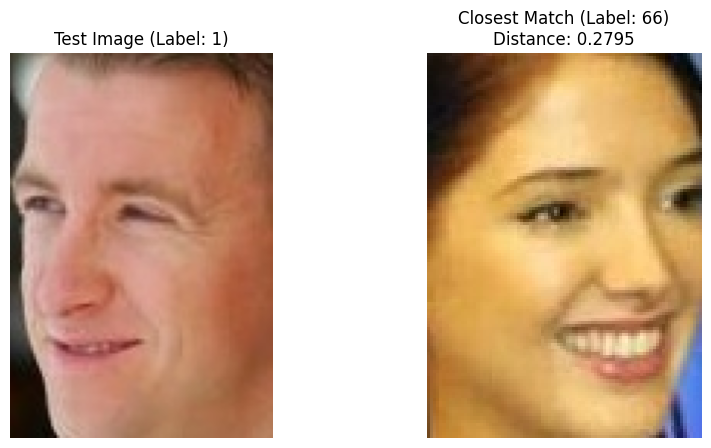

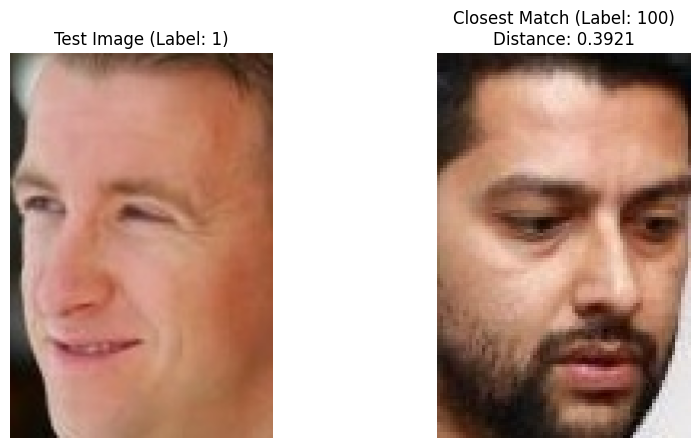

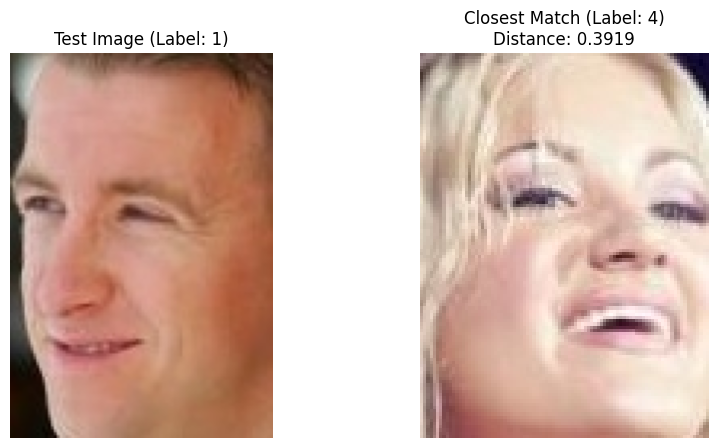

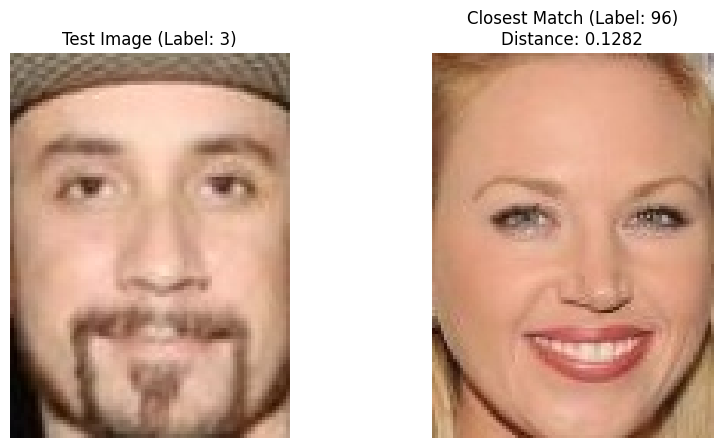

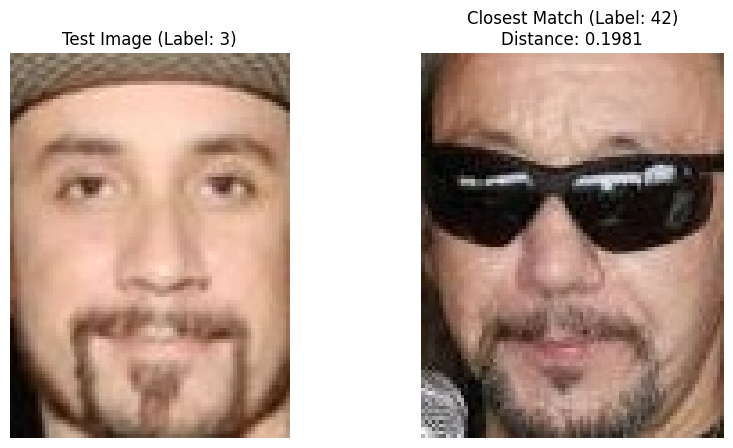

...

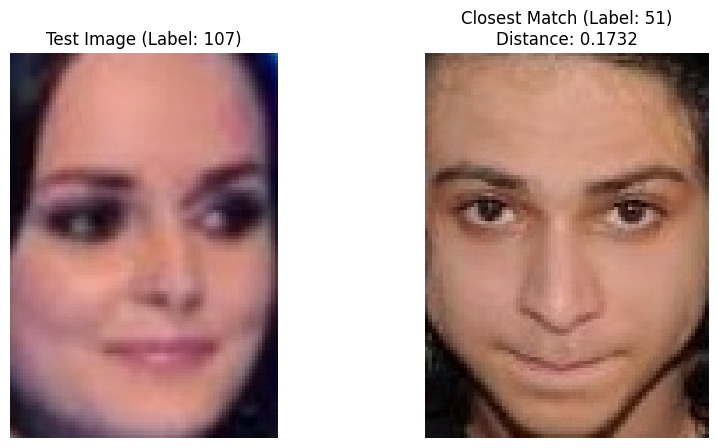

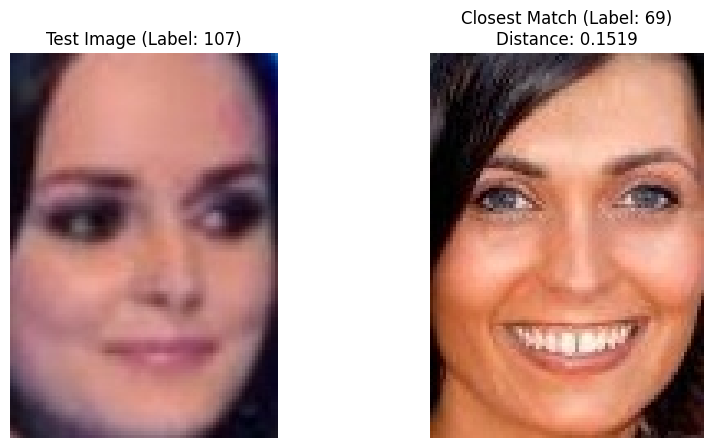

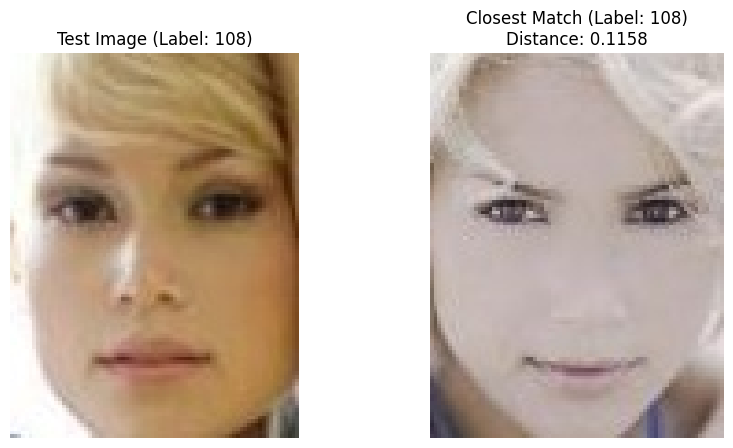

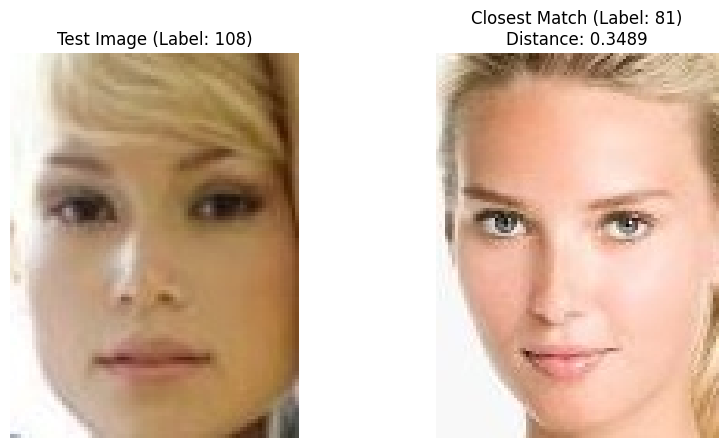

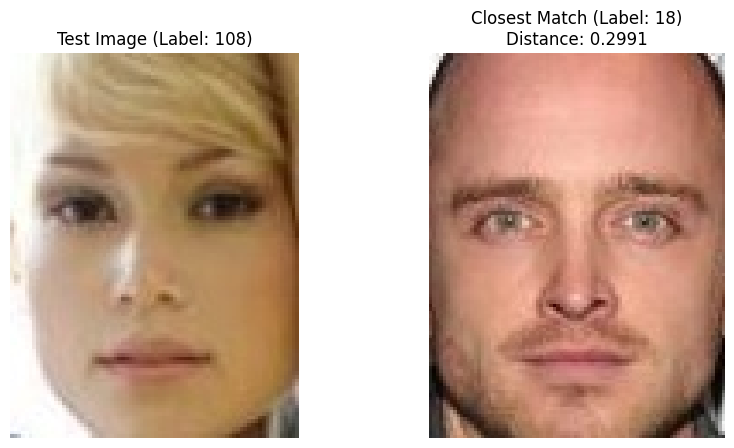

Total Correct Matches: 17 / 291
Percent: 5.8419


In [16]:
correct_matches = 0

for result in results:
    test_label = result['test_label']
    closest_label = result['closest_label']
    closest_distance = result['distance']
    
    
    if test_label == closest_label:
        correct_matches += 1
    
    test_image_name = None
    for img_name, label in test_data:
        if label == test_label:
            test_image_name = img_name
            break

    closest_image_name = None
    for img_name, label in celebrities:
        if label == closest_label:
            closest_image_name = img_name
            break

    test_image_path = os.path.join(images_folder, test_image_name)
    closest_image_path = os.path.join(images_folder, closest_image_name)

    test_image = Image.open(test_image_path).convert("RGB")
    closest_image = Image.open(closest_image_path).convert("RGB")


    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(test_image)
    plt.title(f"Test - Label: {test_label})")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(closest_image)
    plt.title(f"Closest Label: {closest_label})\nDistance: {closest_distance:.4f}")
    plt.axis('off')

    plt.show()

print(f"Total Correct Matches: {correct_matches} / {len(results)}")
print(f"Percent: {(correct_matches/len(results))*100:.3f} %")